# VFT Assignment 4
Written by: Surampally Venkatesh (18AE10028)

This Notebook contains source code and plots with derivations included with 'img' files which are properly readable.

This framework is completly written in python script and based on NumPy and Matplotlib libraries extensively.

Note:- This script is also uploaded in github for remote accesing (It's greatly advised to look in that) https://github.com/venkatesh7979/Aero_Assignments/blob/main/VFT_Assignment_4.ipynb.

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sn
import math
pi=math.pi

# Question 1

Create a video recording of10 minutes (max.) discussing the contributions of your favouritescientistto thedevelopment of fluid mechanicsprior to 1950s. Emphasize on the importance of his/hercontributions from a historical perspective.(30 marks)

Videolink:- https://youtu.be/taeiMfOmpe4

# Question 2

Consider the following flowsa.Hagen-Poiseuille  Flow:  The flow  in  a  long  tube  of  circular  cross-section  under  the action of a difference  between the pressures imposed at  two ends of the tube  was studied by Hagen in 1839 and by Poiseuille flow in 1840. If the flow isassumed to have axial symmetry as the boundary conditions, showthat the streamwisevelocity,𝑢𝑧,isa  function  of  the  radialdistance 𝑟from  theaxis  of  the  tube only.The  general solution to the governing equationfor a pressure gradient,-𝐺,is then given by 𝑢𝑧=𝐺4𝜇(−𝑟2+𝐴𝑙𝑛𝑟+𝐵)–(1)Which reduces to the following expression for a pipe with radius 𝑎,𝑢𝑧=𝐺4𝜇(𝑎2−𝑟2)Compute the volumetricflow rate and the tangential stress at the walland show that the total frictional forceon a pipe of length 𝑙is balanced by the difference in pressure forceacross the two ends.Show thatthe Darcy Friction Factor using the expression for wall shear stressequals64𝑅𝑒where 𝑅𝑒is based on the diameter of the pipe and the mean velocity. Solve the ordinary differential equation numerically and compare with the analytical solution.(15marks)To learn more about the origin of Poiseuille’s Lawread the article:Sutera, S.P. and Skalak, R., 1993. The history of Poiseuille's law.Annual review of fluid mechanics,25(1), pp.1-20.https://www.annualreviews.org/doi/pdf/10.1146/annurev.fl.25.010193.000245
b.Using  the  general  solution (1)  derive  the  expression  for  flow  in  an  annulus  with internal  and  external  radii 𝑎𝑖,𝑎𝑜respectively.Obtain  the  solution numerically  and compare with the analytical solution.(5marks)

Analytical

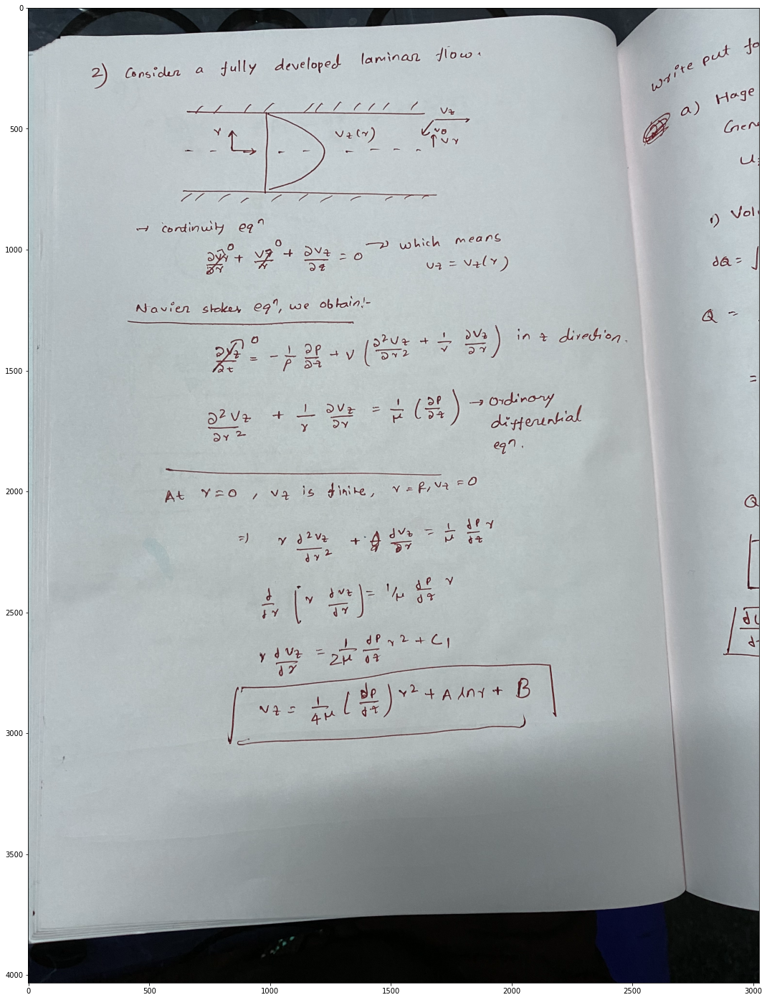

In [272]:
import cv2
img1=cv2.imread('IMG_5102.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

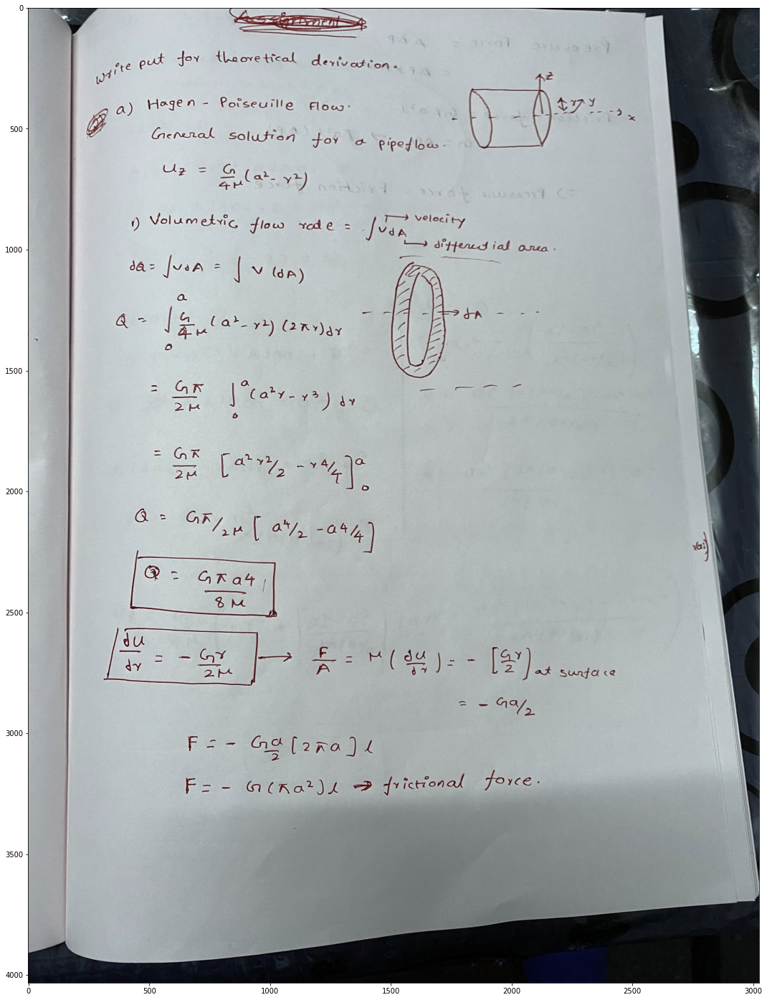

In [273]:
import cv2
img1=cv2.imread('IMG_5103.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

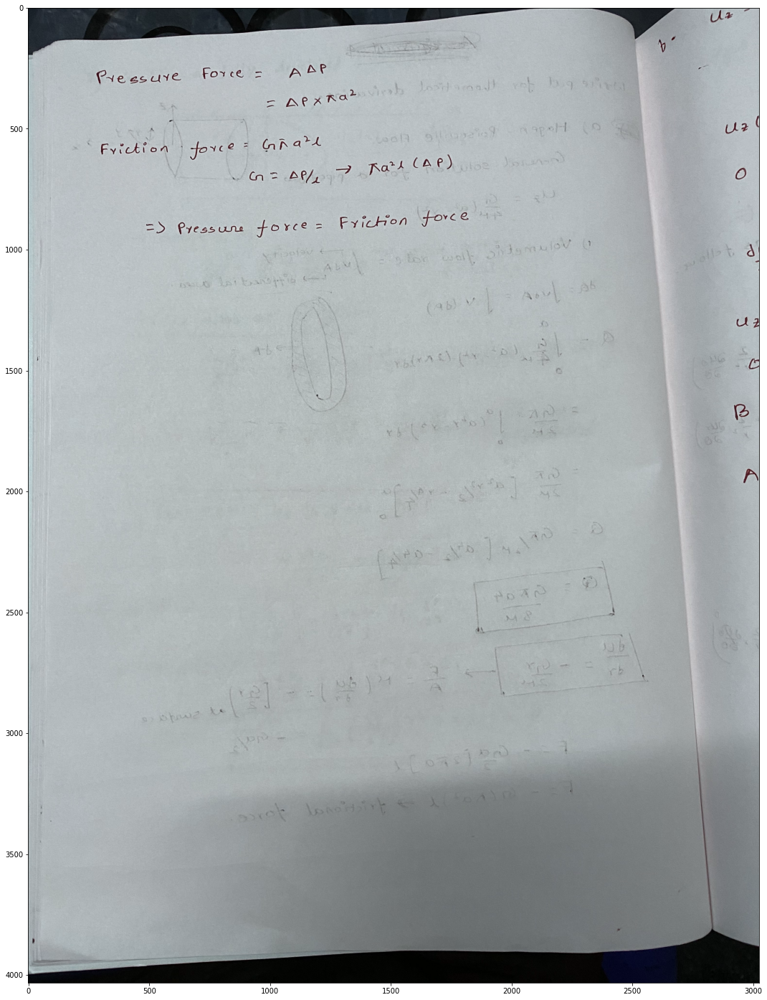

In [274]:
import cv2
img1=cv2.imread('IMG_5104.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

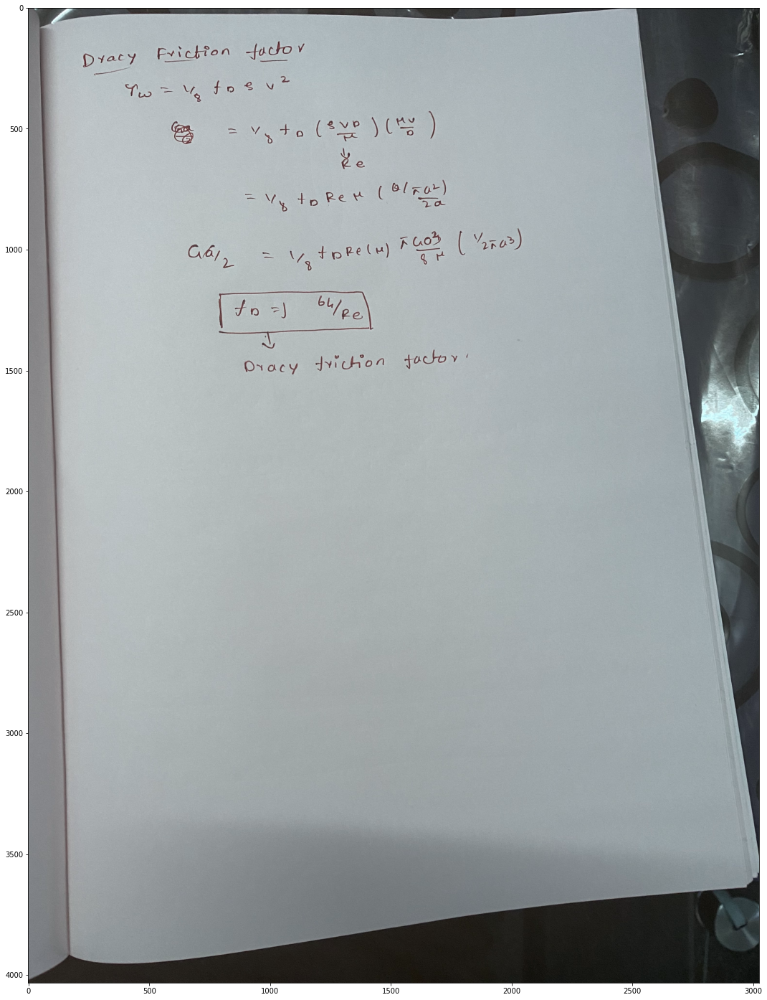

In [276]:
import cv2
img1=cv2.imread('IMG_5125.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

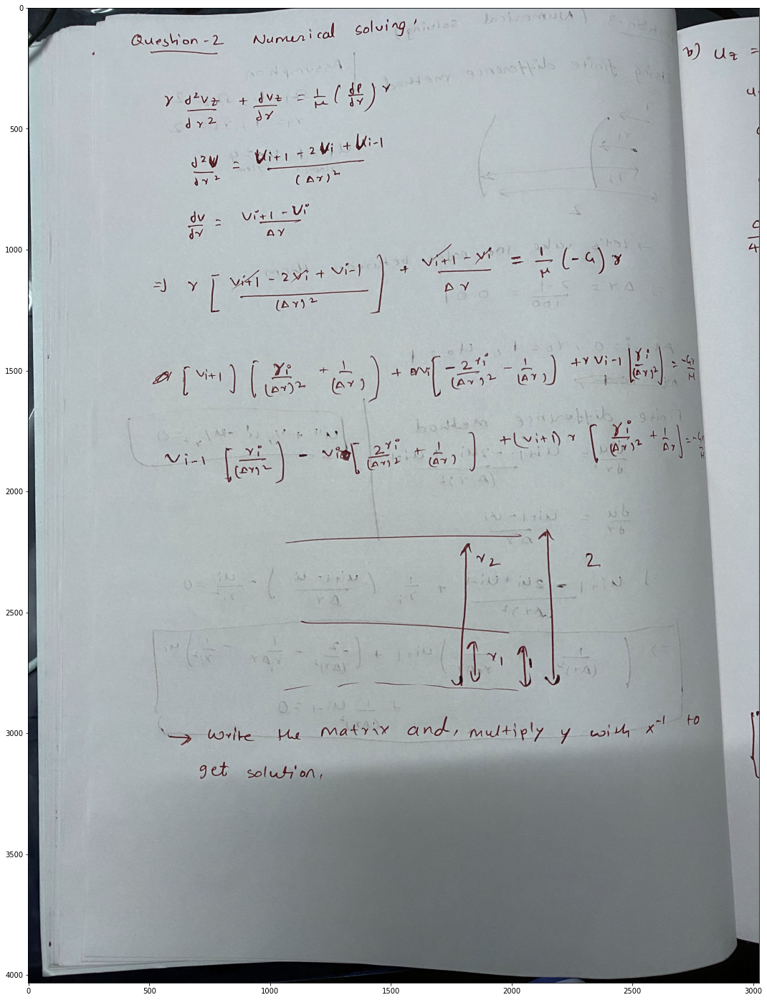

In [261]:
import cv2
img1=cv2.imread('IMG_5099.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

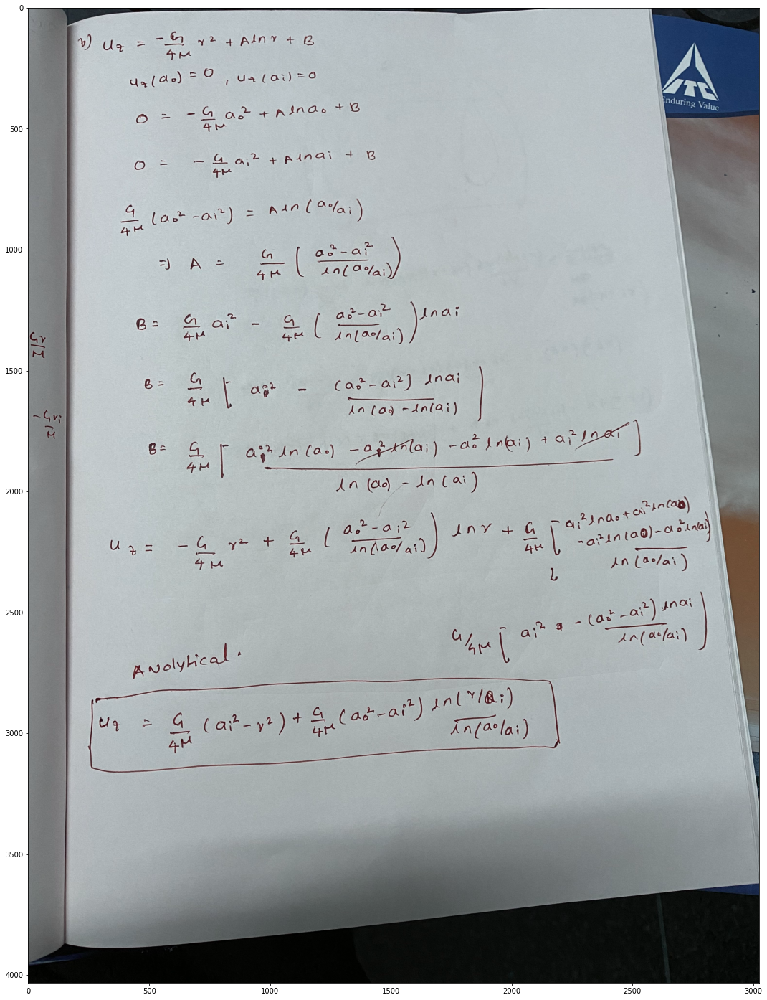

In [260]:
import cv2
img1=cv2.imread('IMG_5100.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

Let's take inner radius of cylinder as 1 and outer radius as 2.

In [262]:
#Set 101 points between radius 1 and 2 
r=np.linspace(1,2,101)
r=r.reshape([101,1])

In [263]:
#Calculate the analytical u at that points
analytical_u=0.25*((1-r**2)+(3)*(np.log(r/1)/np.log(2)))

Text(0.5, 1.0, 'Analytical velocity')

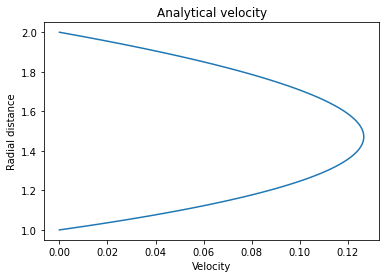

In [264]:
plt.plot(analytical_u,r)
plt.xlabel('Velocity')
plt.ylabel('Radial distance')
plt.title('Analytical velocity')

Numerical

In [265]:
#Create the X and Y matrices
X=np.zeros([101,101])
Y=np.zeros([101,1])

In [266]:
#Set the boundary conditions
X[0,0]=1
X[100,100]=1
Y[0,0]=0
Y[100,0]=0
r0=1
h=0.01

In [267]:
#Calculate the 
j=0
#Assume G=mu
G=1
mu=1
for i in range(1,100):
    ri=r0+i*h
    c=(ri/(h)**2+1/(h))
    b=-1*(2*ri/h**2+1/(h))
    a=ri/(h)**2
    d=(-G/mu)*ri
    X[i,j]=a
    X[i,j+1]=b
    X[i,j+2]=c
    Y[i,0]=d
    j+=1

In [268]:
inversed_matrix=np.linalg.inv(X)
numerical_u=np.matmul(inversed_matrix,Y)

Text(0.5, 1.0, 'Numerical velocity')

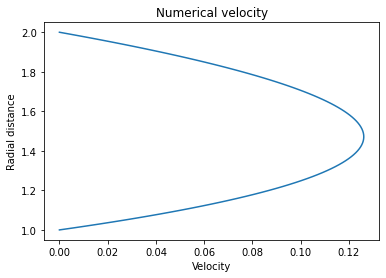

In [269]:
plt.plot(numerical_u,r)
plt.xlabel('Velocity')
plt.ylabel('Radial distance')
plt.title('Numerical velocity')

Error

In [270]:
error=abs(numerical_u-analytical_u)

Text(0.5, 1.0, 'Error vs Radial distance')

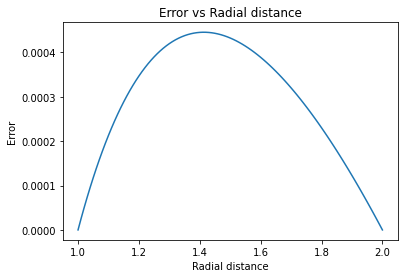

In [271]:
plt.plot(r,error)
plt.xlabel('Radial distance')
plt.ylabel('Error')
plt.title('Error vs Radial distance')

Observation: Numerical and analytical solutions were pretty same and the error is increasing as we move away from the boundary and is decreasing as we move towards the boundary.

# Question 3

Considerthe flow between two rotating cylinders rotating with angular velocityΩ1,Ω2such that 𝑟1≤𝑟≤𝑟2.Here  the  subscripts1,2  referto  the  inner  and the outer  cylinders respectively. Assume that the streamlines are circular so that theonlycomponent of velocity is the tangential velocity,𝑢𝜃.Furthermore,𝑢𝜃is only a function of radial distance,𝑟,and time,𝑡.Simplify  the  Navier-Stokes  equations  by  substituting  this  assumption  to  obtain  a  set  of coupled partial differential equations.Then show that the pressure field must beidentically equal to 0 else the pressure field would becomea multi-valued function.For a steady state flow show that theequation governing𝑢𝜃reduce to an ordinary differential equation and the general solution is given by𝑢𝜃=𝐴𝑟+𝐵𝑟.Calculate𝐴,𝐵byapplying the no-slip condition.Simplifythe expression for the velocity fieldfor  the  case where  the gap  between  the outer  cylinder andthe  inner  cylinder is  very  smallcompared to the radius of the innercylinderand the outer cylinder is not rotating. Computethe frictional couple exerted on the inner and outer cylinders.Solve the ordinary differential equation numerically and compare with the analytical solution.(20 marks)

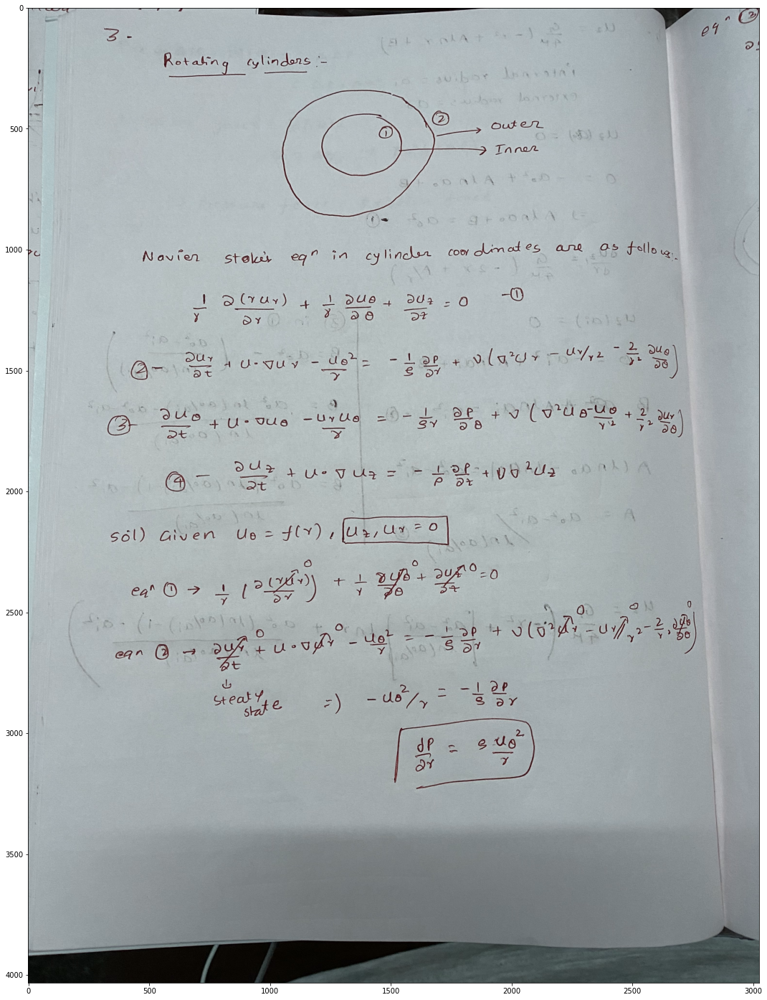

In [107]:
import cv2
img1=cv2.imread('IMG_5078.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

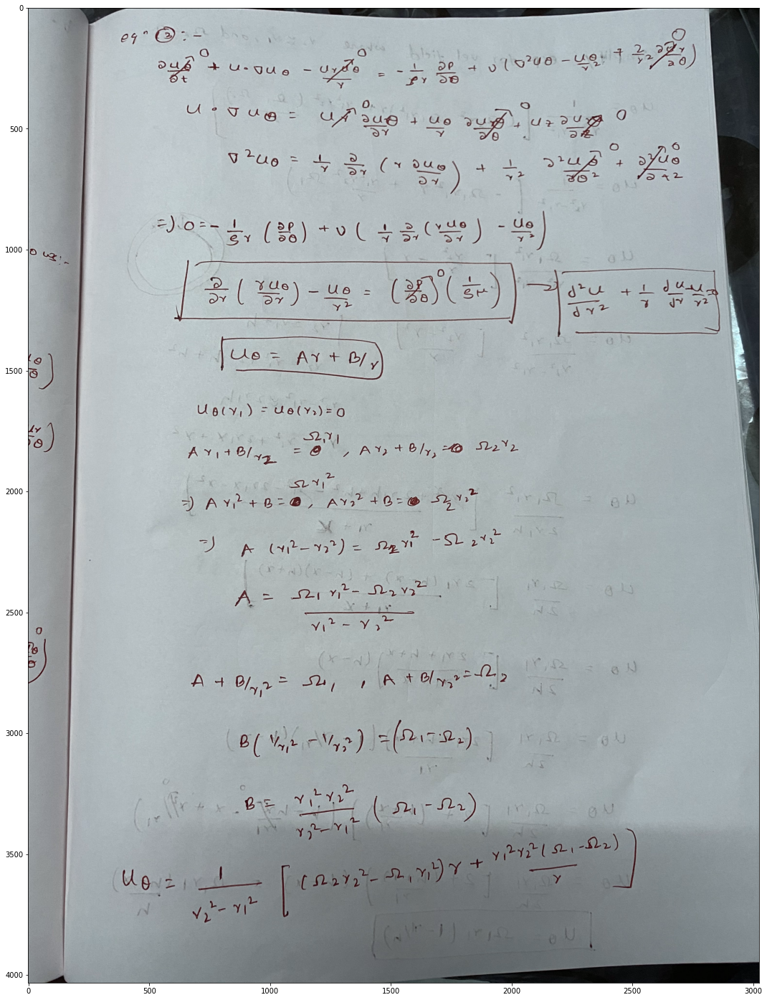

In [108]:
import cv2
img1=cv2.imread('IMG_5079.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

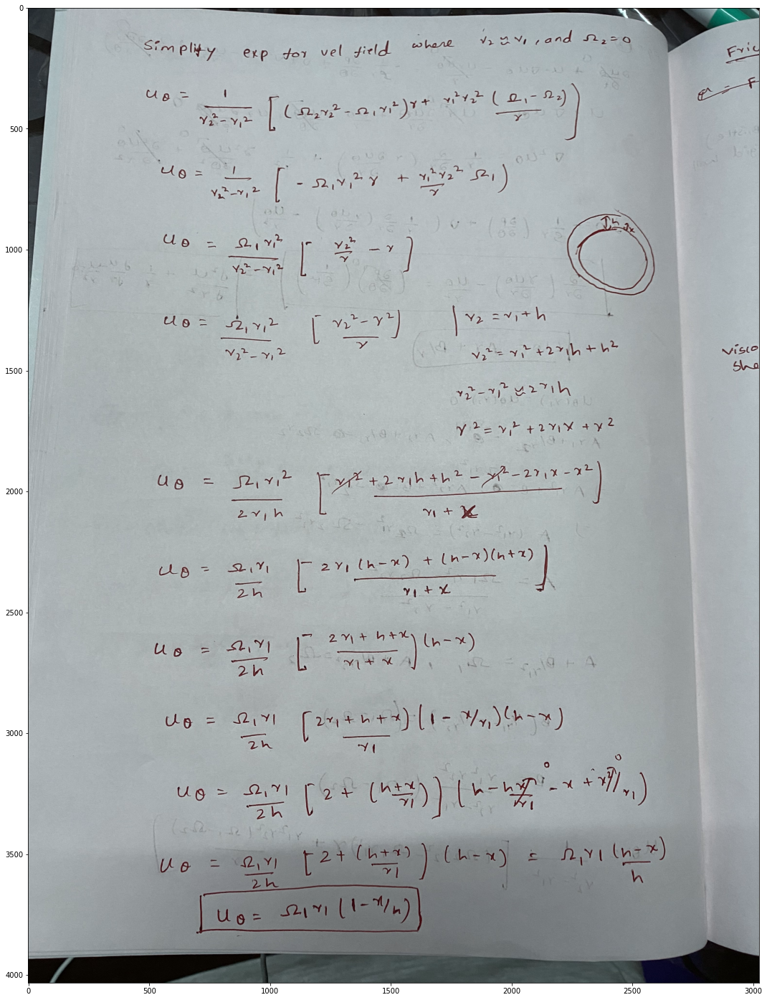

In [109]:
import cv2
img1=cv2.imread('IMG_5080.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

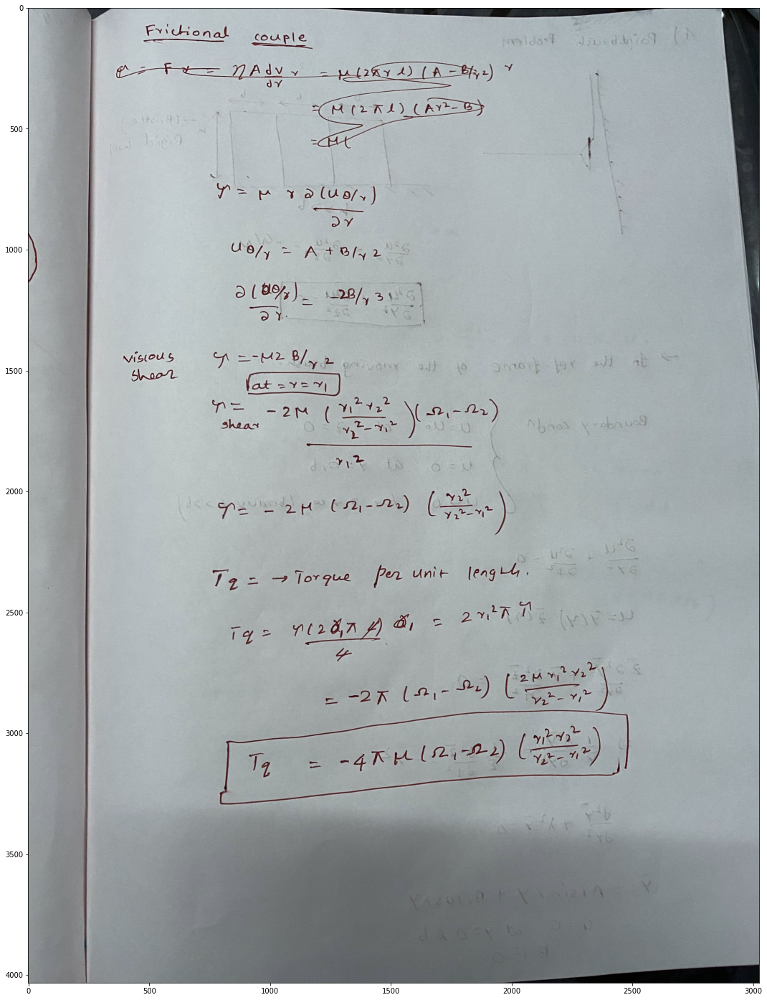

In [110]:
import cv2
img1=cv2.imread('IMG_5081.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

Analytical Method

For analytical method we use omega1=1 r1=1 and omega2=2 r2=2 then substitute this values in the u equation to get u at various r.

In [249]:
#set 101 points between the radius of 1 and 2
r=np.linspace(1,2,101)
r=r.reshape([101,1])

In [250]:
#substitute r in the analytical function to obtain analytical u
analytical_u=(7/3)*r-(4/3)*(1/r)

Numerical Method

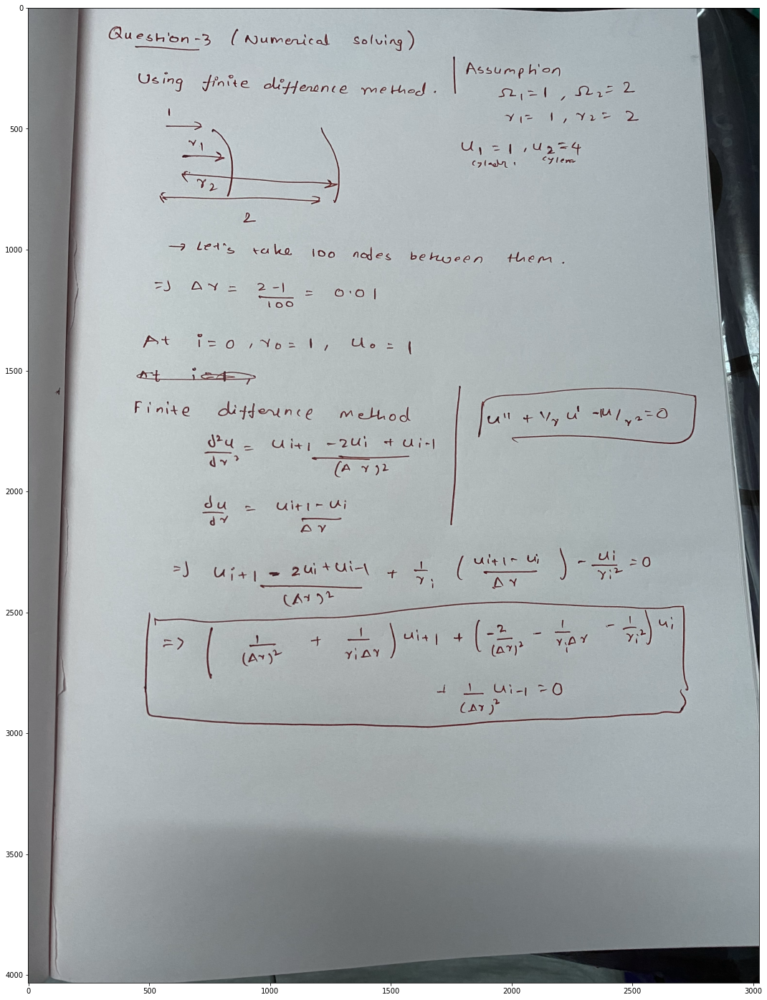

In [111]:
import cv2
img1=cv2.imread('IMG_5082.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

X*u=Y
where terms in X are coefficients of finite differene method, u is the solution.

In [251]:
#Create the X and Y matrices to calculate the solution
X=np.zeros([101,101])
Y=np.zeros([101,1])

Boundary Conditions

In [252]:
#Set the boundary conditions
X[0,0]=1
X[100,100]=1
Y[0,0]=1
Y[100,0]=4
r0=1
h=0.01

In [253]:
#Calculate the numerical value with the aid of finite difference method
j=0
for i in range(1,100):
    ri=r0+i*h
    c=(1/(h)**2+1/(ri*h))
    b=-1*(2/h**2+1/(ri*h)+1/(ri)**2)
    a=1/(h)**2
    X[i,j]=a
    X[i,j+1]=b
    X[i,j+2]=c
    j+=1

In [254]:
#Multiply the inverse matrix of X with Y to obtain the solution
inversed_matrix=np.linalg.inv(X)
numerical_u=np.matmul(inversed_matrix,Y)

Analytical u

Text(0.5, 1.0, 'Analytical Tangential velocity vs Radial distance')

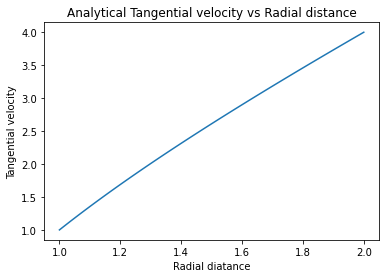

In [255]:
plt.plot(r,analytical_u)
plt.xlabel('Radial diatance')
plt.ylabel('Tangential velocity')
plt.title('Analytical Tangential velocity vs Radial distance')

Numerical u

Text(0.5, 1.0, 'Numerical Tangential velocity vs Radial distance')

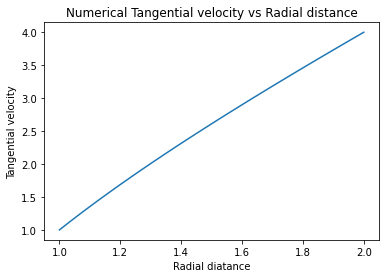

In [256]:
plt.plot(r,numerical_u)
plt.xlabel('Radial diatance')
plt.ylabel('Tangential velocity')
plt.title('Numerical Tangential velocity vs Radial distance')

Error plot

In [257]:
error=abs(numerical_u-analytical_u)

Text(0.5, 1.0, 'Error vs Radial distance')

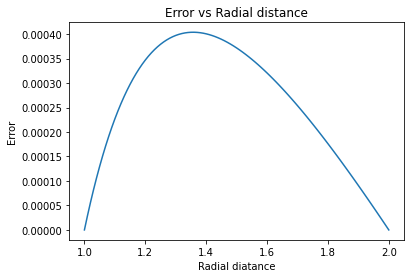

In [258]:
plt.plot(r,error)
plt.xlabel('Radial diatance')
plt.ylabel('Error')
plt.title('Error vs Radial distance')

Observation: Numerical and analytical solutions were pretty same and the error is increasing as we move away from the boundary and is decreasing as we move towards the boundary.

# Question no-4

Compute  the  numerical  solution  of  themodel Paintbrush  problem(Page  183  of“An Introduction to Fluid Dynamics”by G KBatchelor)and compare with the analytical solution.Plot  the  error,  the  residual  as  a  function  of  iterations  and  the  grid  resolution. Explain  your obervations.(30 marks)

Solving the equation numerically with finite difference method.

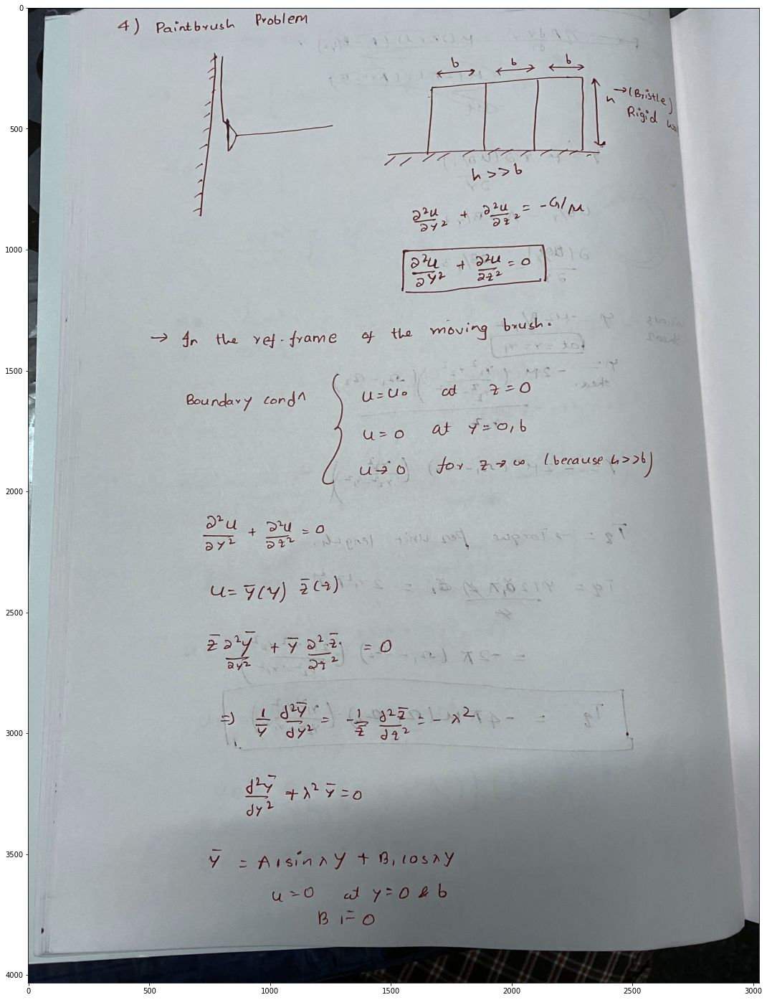

In [247]:
import cv2
img1=cv2.imread('IMG_5096.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

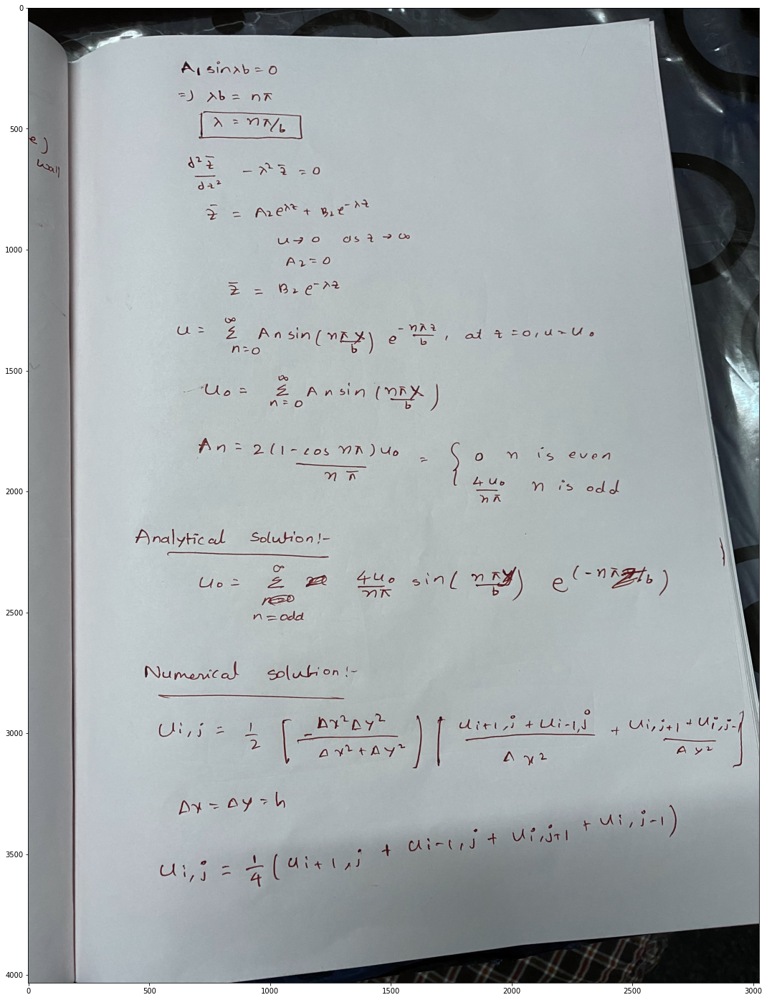

In [248]:
import cv2
img1=cv2.imread('IMG_5097.jpg')
plt.figure(figsize=(25, 25))
plt.imshow(img1)

In [4]:
#Generating the mesh grid
dy=0.002
dz=0.002
y = np.arange(0, 1.002, dy)
z = np.arange(0, 1.002, dz)
Y, Z = np.meshgrid(y, z)

In [7]:
#Setting up the stop conditions and a,b
a=1
b=1
max_iteration=20000
tol=0.0001

In [5]:
#Initialize the analytical sulution matrix with zeros
ux_analytic=np.zeros([len(y),len(z)])

In [8]:
#Compute the analytical solution of u with analytical function
for n in range(1,15000,2):
    ux_analytic+=((4/(n*pi))*np.sin(n*pi*Y/b)*np.exp(-n*pi*Z/b))

Numerical solving

In [210]:
#Initialize the numerical solution matrix with zeros
ux=np.zeros([len(z),len(y)])
#Set the Boundary conditions
ux[0,:]=ux_analytic[0,:]
ux[len(x)-1,:]=ux_analytic[len(x)-1,:]
ux[:,0]=ux_analytic[:,0]
ux[:,len(y)-1]=ux_analytic[:,len(y)-1]

In [212]:
#Solve the numerical solution with finite difference method
iteration=1
residual=1
resi=[]
while (iteration<=max_iteration or residual<tol):# && residual<tol):
    for i in range(1,len(x)-1):
        for j in range(1,len(y)-1):
            ux[i,j]=0.25*(ux[i+1,j]+ux[i-1,j]+ux[i,j+1]+ux[i,j-1])
    resi.append(max([np.amax(ux_analytic-ux),abs(np.amin(ux_analytic-ux))]))
    residual=max([np.amax(ux_analytic-ux),abs(np.amin(ux_analytic-ux))])
    iteration+=1
    #Report the iteration number after every 1000 iterations
    if(iteration%1000==0):
        print(iteration)

1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000


In [213]:
#Numerical solution matrix
ux

array([[0.00000000e+00, 9.93246729e-01, 9.96622728e-01, ...,
        9.96622728e-01, 9.93246729e-01, 1.16961256e-12],
       [0.00000000e+00, 4.97429857e-01, 6.95309489e-01, ...,
        6.95309766e-01, 4.97429996e-01, 1.29587504e-14],
       [0.00000000e+00, 3.01163214e-01, 4.98491503e-01, ...,
        4.98492056e-01, 3.01163492e-01, 6.59071532e-15],
       ...,
       [0.00000000e+00, 3.45989823e-04, 6.91965849e-04, ...,
        6.91991659e-04, 3.46002799e-04, 6.83651201e-18],
       [0.00000000e+00, 3.48547152e-04, 6.97080335e-04, ...,
        6.97080335e-04, 3.48547152e-04, 6.79352883e-18],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 6.75081792e-18]])

In [206]:
#Analytical solution matrix
ux_analytic

array([[0.00000000e+00, 9.93246729e-01, 9.96622728e-01, ...,
        9.96622728e-01, 9.93246729e-01, 1.16961256e-12],
       [0.00000000e+00, 4.99995811e-01, 7.04824387e-01, ...,
        7.04824387e-01, 4.99995811e-01, 1.29587504e-14],
       [0.00000000e+00, 2.95158858e-01, 4.99983245e-01, ...,
        4.99983245e-01, 2.95158858e-01, 6.59071532e-15],
       ...,
       [0.00000000e+00, 3.50752436e-04, 7.01490812e-04, ...,
        7.01490812e-04, 3.50752436e-04, 6.83651201e-18],
       [0.00000000e+00, 3.48547152e-04, 6.97080335e-04, ...,
        6.97080335e-04, 3.48547152e-04, 6.79352883e-18],
       [0.00000000e+00, 3.46355837e-04, 6.92697795e-04, ...,
        6.92697795e-04, 3.46355837e-04, 6.75081792e-18]])

Text(0.5, 1.0, 'Max Error/Residual vs Number of iterations')

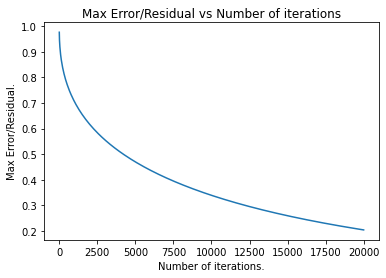

In [216]:
plt.plot(resi)
plt.xlabel('Number of iterations.')
plt.ylabel('Max Error/Residual.')
plt.title('Max Error/Residual vs Number of iterations')

Meshgrid resolution vs Residual

In [228]:
resolution=[0.001,0.002, 0.003, 0.004 ,0.005, 0.006, 0.007, 0.008,0.009,0.01]

In [237]:
resi=[]
for h in resolution:
    #Generating the mesh grid
    dy=h
    dz=h
    y = np.arange(0, 1.001, dy)
    z = np.arange(0, 1.001, dz)
    Y, Z = np.meshgrid(y, z)
    #Setting up the stop conditions and a,b
    a=1
    b=1
    max_iteration=1000
    tol=0.0001
    #Initialize the analytical sulution matrix with zeros
    ux_analytic=np.zeros([len(y),len(z)])
    #Compute the analytical solution of u with analytical function
    for n in range(1,15000,2):
        ux_analytic+=((4/(n*pi))*np.sin(n*pi*Y/b)*np.exp(-n*pi*Z/b))
    #Initialize the numerical solution matrix with zeros
    ux=np.zeros([len(z),len(y)])
    #Set the Boundary conditions
    ux[0,:]=ux_analytic[0,:]
    ux[len(y)-1,:]=ux_analytic[len(y)-1,:]
    ux[:,0]=ux_analytic[:,0]
    ux[:,len(y)-1]=ux_analytic[:,len(y)-1]
    #Solve the numerical solution with finite difference method
    iteration=1
    residual=1
    while (iteration<=max_iteration or residual<tol):# && residual<tol):
        for i in range(1,len(z)-1):
            for j in range(1,len(y)-1):
                ux[i,j]=0.25*(ux[i+1,j]+ux[i-1,j]+ux[i,j+1]+ux[i,j-1])
        residual=max([np.amax(ux_analytic-ux),abs(np.amin(ux_analytic-ux))])
        iteration+=1
        #Report the iteration number after every 1000 iterations
    print(h)
    resi.append(max([np.amax(ux_analytic-ux),abs(np.amin(ux_analytic-ux))]))

0.001
0.002
0.003
0.004
0.005
0.006
0.007
0.008
0.009
0.01


Text(0.5, 1.0, 'Mesh grid resolution vs Residual/Error')

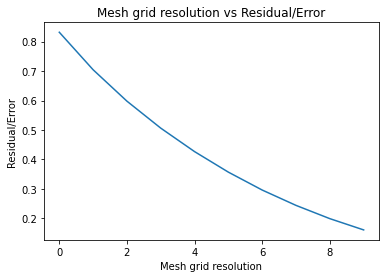

In [245]:
plt.plot(resi)
plt.xlabel('Mesh grid resolution')
plt.ylabel('Residual/Error')
plt.title('Mesh grid resolution vs Residual/Error')

Observation:- Error/Residual is decreasing with grid resolution.

In [9]:
ux_analytic

array([[0.00000000e+00, 9.93246729e-01, 9.96622728e-01, ...,
        9.96622728e-01, 9.93246729e-01, 1.16961256e-12],
       [0.00000000e+00, 4.99995811e-01, 7.04824387e-01, ...,
        7.04824387e-01, 4.99995811e-01, 1.29587504e-14],
       [0.00000000e+00, 2.95158858e-01, 4.99983245e-01, ...,
        4.99983245e-01, 2.95158858e-01, 6.59071532e-15],
       ...,
       [0.00000000e+00, 3.50752436e-04, 7.01490812e-04, ...,
        7.01490812e-04, 3.50752436e-04, 6.83651201e-18],
       [0.00000000e+00, 3.48547152e-04, 6.97080335e-04, ...,
        6.97080335e-04, 3.48547152e-04, 6.79352883e-18],
       [0.00000000e+00, 3.46355837e-04, 6.92697795e-04, ...,
        6.92697795e-04, 3.46355837e-04, 6.75081792e-18]])

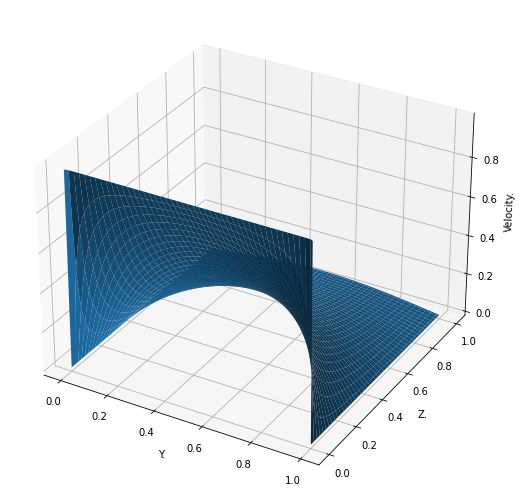

In [16]:
from mpl_toolkits import mplot3d 
# Creating figyre 
fig = plt.figure(figsize =(14, 9)) 
ax = plt.axes(projection ='3d') 
# Creating plot 
ax.plot_surface(Y,Z, ux_analytic)
ax.set_xlabel('Y.')
ax.set_ylabel('Z.')
ax.set_zlabel('Velocity.')
# show plot 
plt.show() 

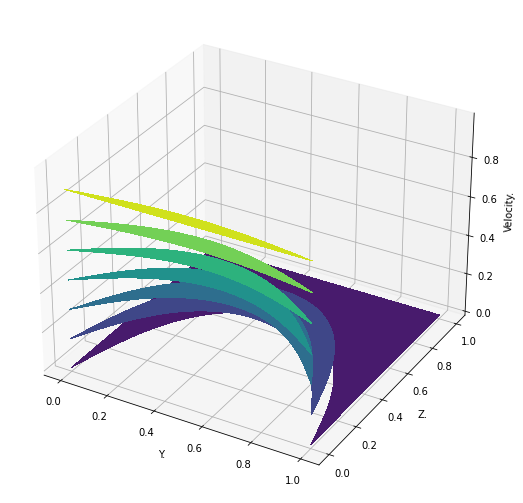

In [17]:
from mpl_toolkits import mplot3d 
# Creating figyre 
fig = plt.figure(figsize =(14, 9)) 
ax = plt.axes(projection ='3d') 
# Creating plot 
ax.contourf(Y,Z, ux_analytic)
ax.set_xlabel('Y.')
ax.set_ylabel('Z.')
ax.set_zlabel('Velocity.')
# show plot 
plt.show() 

Analytical and Numerical solutions are pretty similar.